# Hyperparameter Optimization with Bayesian Search Cross-Validation

In this notebook, we examine train several models, examine their performance, and create visualizations for these models related to explanations and their performance.

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from scipy import stats
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score, mean_squared_error
import statsmodels.api as sm
from sklearn.ensemble import RandomForestRegressor
from xgboost import XGBRegressor
from skopt import BayesSearchCV
from skopt.space import Real, Integer
import joblib
import mpl_scatter_density
from matplotlib.colors import LinearSegmentedColormap
import shap
from sklearn.inspection import PartialDependenceDisplay, permutation_importance, partial_dependence
from PyALE import ale

pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

## Data

In [2]:
data = pd.read_csv('data/data.csv', low_memory=False)

In [3]:
data['Coastal?'] = data['Coastal?'].fillna(False).astype(int)

mapping_dict = {'Arid': 0, 'Snow': 1, 'Temperate': 2, 'Tropical': 3}
data['Climate Zone'] = data['Climate Zone'].map(mapping_dict)

In [4]:
features = ['Built Fraction', 'Grass Fraction', 'Tree Fraction', 
            'Built Albedo', 'Grass Albedo', 'Tree Albedo', 
            'Elevation', 'Climate Zone', 'Coastal?']

## Helper Functions

In [5]:
def get_data(label, test_size=0.20):
    df = data[features+[label]].dropna().copy()
    X  = df[features]
    y  = df[label]
    
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=test_size,  random_state=1, shuffle=True)
    return X_train, X_test, y_train, y_test

In [6]:
def get_linear_model(label):
    df = data[features+[label]].dropna().copy()
    X  = df[features]
    X  = sm.add_constant(X)
    y  = df[label]
    
    model   = sm.OLS(y, np.asarray(X))
    results = model.fit()
    return results

- [Density Scatter Plot Code](https://stackoverflow.com/questions/20105364/how-can-i-make-a-scatter-plot-colored-by-density)
- [Density Scatter Plot Library](https://github.com/astrofrog/mpl-scatter-density/tree/main)

We limit the x and y axis of the performance graphs between the 99th percentile of target in the test set. We round up the highest absolute value both tails, and take the maximum of either the right or left tail.

In [7]:
# Test Performance Graphs
def performance_graphs(model_xgb, model_rf, X_test, y_test, label):
    model_linear = get_linear_model(label)
    
    models = [model_xgb, model_rf, model_linear]
    titles = ['XGBoost', 'Random Forest', 'OLS']
    
    if (label == 'CUHI Day'):
        lim = [-3,3]
    if (label == 'CUHI Night'):
        lim = [-2,2]
    if label == 'SUHI Day':
        lim = [-9,9]
    if label == 'SUHI Night':
        lim = [-3,3]       
    
    # "Viridis-like" colormap with white background
    white_viridis = LinearSegmentedColormap.from_list('white_viridis', [
        (0, '#ffffff'),
        (1e-20, '#440053'),
        (0.2, '#404388'),
        (0.4, '#2a788e'),
        (0.6, '#21a784'),
        (0.8, '#78d151'),
        (1, '#fde624'),
    ], N=256)

    font = {'size': 14}
    plt.rc('font', **font)
    # Set the font family to 'Verdana'
    plt.rcParams["font.family"] = "sans-serif"
    plt.rcParams["font.sans-serif"] = ["Verdana"]
    nrows, ncols = 1, len(models)
    fig = plt.figure(figsize=(15,5), constrained_layout=True, dpi=1000)
    dpi = 30
    for i in range(len(models)-1):
        y_pred = models[i].predict(X_test)
        rmse = mean_squared_error(y_test, y_pred, squared = False)
        r2   = r2_score(y_test, y_pred)
        mbe  = np.mean(y_pred - y_test)
        # Scatter Density Plot
        ax = fig.add_subplot(nrows, ncols, i+1, projection='scatter_density')
        density = ax.scatter_density(y_test, y_pred, cmap=white_viridis, dpi=dpi)
        ax.set_xlabel('Observed {}'.format(label), fontsize=14)
        if i == 0:
            ax.set_ylabel('Predicted {}'.format(label), fontsize=14)
        #ax.set_title(titles[i], fontsize=16)
        # Line of Best Fit
        slope, intercept, r_value, p_value, std_err = stats.linregress(y_test, y_pred)
        y_pred_scipy = slope * y_test + intercept
        ax.plot(y_test, y_pred_scipy, color='black', linestyle='solid', label=f"y = {slope:.2f}x + {intercept:.2f}; $R^2$={r_value ** 2:.2f}\nRMSE={rmse:.2f}; MBE=${mbe:.2f}$")
        ax.legend(loc='upper left')
        # Perfect Performance Line
        ax.plot(y_test, y_test, linestyle='dashed', color='red')
        ax.set_xlim(lim)
        ax.set_ylim(lim)
        #ax.text(.01, .87, 'RMSE=${:.2f}$\u00b0C \nMBE=${:.2f}$\u00b0C'.format(rmse,mbe), ha='left', va='top', transform=ax.transAxes, fontsize=14)

    y_pred = model_linear.predict(sm.add_constant(X_test))
    rmse = mean_squared_error(y_test, y_pred, squared = False)
    r2   = r2_score(y_test, y_pred)
    mbe  = np.mean(y_pred - y_test)
    ax = fig.add_subplot(nrows, ncols, len(models), projection='scatter_density')
    density = ax.scatter_density(y_test, y_pred, cmap=white_viridis, dpi=dpi)
    #fig.colorbar(density, label='Sample Density')
    ax.set_xlabel('Observed {}'.format(label), fontsize=14)
    #ax.set_title(titles[-1], fontsize=16)
    # Line of Best Fit
    slope, intercept, r_value, p_value, std_err = stats.linregress(y_test, y_pred)
    y_pred_scipy = slope * y_test + intercept
    ax.plot(y_test, y_pred_scipy, color='black', linestyle='solid', label=f"y = {slope:.2f}x + {intercept:.2f}; $R^2$={r_value ** 2:.2f}\nRMSE={rmse:.2f}; MBE=${mbe:.2f}$")
    ax.legend(loc='upper left')
    # Perfect Performance Line
    ax.plot(y_test, y_test, linestyle='dashed', color='red')
    ax.set_xlim(lim)
    ax.set_ylim(lim)
    #ax.text(.01, .87, 'RMSE=${:.2f}$\u00b0C \nMBE=${:.2f}$\u00b0C'.format(rmse,mbe), ha='left', va='top', transform=ax.transAxes, fontsize=14)    
    plt.savefig('graphs/performance/performance_{}.svg'.format(label), dpi=1000, transparent=True)
    plt.savefig('graphs/performance/performance_{}.pdf'.format(label), dpi=1000, transparent=True)
    plt.savefig('graphs/performance/300dpi/performance_{}.svg'.format(label), dpi=300, transparent=True)
    plt.savefig('graphs/performance/300dpi/performance_{}.pdf'.format(label), dpi=300, transparent=True)
    plt.savefig('graphs/performance/jpg/performance_{}.jpg'.format(label), dpi=1000, transparent=True)

In [8]:
def plot_feature_importance(model, model_name, X_test, y_test, label):
    """This function plots the permutation importance, mean absolute SHAP values, and SHAP beeswarm plots."""

    # Permutation Importance
    N_REPEATS = 10
    plt.rcParams.update({'font.size': 14}) # Set font size
    # Set the font family to 'Verdana'
    plt.rcParams["font.family"] = "sans-serif"
    plt.rcParams["font.sans-serif"] = ["Verdana"]
    
    result = permutation_importance(
    model, X_test, y_test, n_repeats=N_REPEATS, random_state=42, n_jobs=2
    )

    sorted_importances_idx = result.importances_mean.argsort()
    importances = pd.DataFrame(
        result.importances[sorted_importances_idx].T,
        columns=X_test.columns[sorted_importances_idx],
    )
    ax = importances.plot.box(vert=False, whis=(0,100), figsize=(5,5))
    ax.axvline(x=0, color="k", linestyle="--")
    ax.set_xlabel('Permutation Importance')
    ax.yaxis.set_tick_params(left=False)
    ax.figure.tight_layout()
    plt.savefig('graphs/variable_importance/cross_val/permutation_importance_{}_{}.svg'.format(model_name, label), bbox_inches='tight', dpi=1000, transparent=True)
    plt.savefig('graphs/variable_importance/cross_val/permutation_importance_{}_{}.pdf'.format(model_name, label), bbox_inches='tight', dpi=1000, transparent=True)    
    plt.savefig('graphs/variable_importance/cross_val/300dpi/permutation_importance_{}_{}.svg'.format(model_name, label), bbox_inches='tight', dpi=300, transparent=True)
    plt.savefig('graphs/variable_importance/cross_val/300dpi/permutation_importance_{}_{}.pdf'.format(model_name, label), bbox_inches='tight', dpi=300, transparent=True)
    plt.savefig('graphs/variable_importance/cross_val/jpg/permutation_importance_{}_{}.jpg'.format(model_name, label), bbox_inches='tight', dpi=1000, transparent=True)
 
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10,5), dpi=1000)
    # SHAP
    explainer = shap.TreeExplainer(model, approximate=True)
    shap_values = explainer(X_test)
    # Create a SHAP bar and beeswarm plot
    plt.sca(ax1)
    shap.plots.bar(shap_values, max_display=10, show=False)
    plt.sca(ax2)
    shap.plots.beeswarm(shap_values, max_display=10, show=False)
    ax2.tick_params(axis='y', which='both', left=False, labelleft=False)
    ax2.set_xlabel('SHAP value')
    plt.subplots_adjust(
        wspace = 0.1)
    fig.set_size_inches(10, 5)

    plt.savefig('graphs/variable_importance/cross_val/shap_{}_{}.svg'.format(model_name, label), bbox_inches='tight', dpi=1000, transparent=True)
    plt.savefig('graphs/variable_importance/cross_val/shap_{}_{}.pdf'.format(model_name, label), bbox_inches='tight', dpi=1000, transparent=True)
    plt.savefig('graphs/variable_importance/cross_val/300dpi/shap_{}_{}.svg'.format(model_name, label), bbox_inches='tight', dpi=300, transparent=True)
    plt.savefig('graphs/variable_importance/cross_val/300dpi/shap_{}_{}.pdf'.format(model_name, label), bbox_inches='tight', dpi=300, transparent=True)
    plt.savefig('graphs/variable_importance/cross_val/jpg/shap_{}_{}.jpg'.format(model_name, label), bbox_inches='tight', dpi=1000, transparent=True)

In [9]:
def plot_feature_effect(model, model_name, X_test, y_test, label):
    """This function plots the feature importance for PDP, ALE, and individual SHAP values."""
    # Get SHAP values
    explainer = shap.TreeExplainer(model, approximate=True)
    shap_values = explainer(X_test)
    shap_df = pd.DataFrame(
        np.c_[shap_values.base_values, shap_values.values],
        columns = ["BaseValue"] + list(X_test.columns)
    )
    figsize = (12,12)
    ref    = ['A', 'B', 'C', 'D', 'E', 'F', 'G', 'H', 'I']
    labels = features
    font = {'size': 14}
    plt.rc('font', **font)
    # Set the font family to 'Verdana'
    plt.rcParams["font.family"] = "sans-serif"
    plt.rcParams["font.sans-serif"] = ["Verdana"]
    nrows, ncols = 3, 3
    fig, axes = plt.subplots(nrows=nrows, ncols=ncols,figsize=figsize, constrained_layout=True, sharey=True, dpi=1000)
    for k, ax in enumerate(axes.flatten()):
        if features[k] == 'Coastal?':
            x = ['No', 'Yes']
        if features[k] == 'Climate Zone':
            x = ['Arid', 'Snow', 'Temperate', 'Tropical']
            
        # Plot PDP
        pdp = partial_dependence(model, X_test, features=features[k], kind='average', percentiles=(0,1))
        
        if (features[k] != 'Coastal?') and (features[k] != 'Climate Zone'):
            x = pdp['grid_values'][0]
        
        ax.plot(x, pdp['average'][0], label='PDP', color='#DC267F', linewidth=2.5) # magenta
        
        # Plot ALE
        ale_eff = ale(X=X_test[features], model=model, feature=[features[k]], grid_size=100, include_CI=False, plot=False)
        ale_eff = ale_eff.reset_index()
        
        if (features[k] != 'Coastal?') and (features[k] != 'Climate Zone'):
            x = ale_eff[features[k]]
        
        ax.plot(x, ale_eff['eff'], label='ALE', color='#785EF0', linewidth=2.5) # 648FFF
        
        # Scatter plot of SHAP values
        ax.scatter(x=X_test[features[k]], y=shap_df[features[k]], label='SHAP', s=1, color='#FFB000', alpha=0.5) #FFD900
        
        # Subplot Label References
        ax.set_xlabel(labels[k])
        ax.text(.01, .98, ref[k], ha='left', va='top', transform=ax.transAxes, fontsize=16)
        
        if (label == 'CUHI Day') | (label == 'CUHI Night'):
            ylim = [-1,1]
        if label == 'SUHI Day':
            ylim = [-4,4]
        if label == 'SUHI Night':
            ylim = [-2,2]
        ax.set_ylim(ylim)
    for n in range(nrows):
        axes[n,0].set_ylabel(label)
    #axes[0,0].legend(bbox_to_anchor=(0.4,1.2), loc='right')
    axes[0,0].legend(loc='lower right')
    plt.savefig('graphs/variable_importance/cross_val/feature_effect_{}_{}.svg'.format(model_name, label), bbox_inches='tight', dpi=1000, transparent=True)
    plt.savefig('graphs/variable_importance/cross_val/feature_effect_{}_{}.pdf'.format(model_name, label), bbox_inches='tight', dpi=1000, transparent=True)
    plt.savefig('graphs/variable_importance/cross_val/300dpi/feature_effect_{}_{}.svg'.format(model_name, label), bbox_inches='tight', dpi=1000, transparent=True)
    plt.savefig('graphs/variable_importance/cross_val/300dpi/feature_effect_{}_{}.pdf'.format(model_name, label), bbox_inches='tight', dpi=1000, transparent=True)
    plt.savefig('graphs/variable_importance/cross_val/jpg/feature_effect_{}_{}.jpg'.format(model_name, label), bbox_inches='tight', dpi=1000, transparent=True)
    

In [10]:
def run_search(label, n_folds=10, n_iter = 20):
#def run_search(label, n_folds=5, n_iter = 10):
    X_train, X_test, y_train, y_test = get_data(label)
    
    # Define search space
    search_space = {
        'max_depth':  Integer(10, 15), # Integer(5, 7),
        'n_estimators': Integer(100, 150) # Integer(10, 15)  
    }
    
    # Create model
    model_rf = RandomForestRegressor(random_state=1)

    # Perform Bayesian optimization with cross validation
    print('Random Forest')
    bayes_search_rf = BayesSearchCV(estimator=model_rf, search_spaces=search_space, n_iter=n_iter, cv=n_folds, n_jobs=-1, 
                                    error_score='raise', return_train_score=True, scoring = 'neg_root_mean_squared_error')
    bayes_search_rf.fit(X_train, y_train)
    
    plot_feature_importance(bayes_search_rf.best_estimator_, 'rf', X_test, y_test, label)
    plot_feature_effect(bayes_search_rf.best_estimator_, 'rf', X_test, y_test, label)
    
    # Print best score and parameters
    print(f"Best score RF: {bayes_search_rf.best_score_:.3f}")
    print(f"Best parameters RF: {bayes_search_rf.best_params_}")
    
    # Create model
    model_xgb = XGBRegressor(importance_type='gain', random_state=1, enable_categorical=True, tree_method='hist', grow_policy = 'lossguide')

    # Perform Bayesian optimization with cross validation
    print('\nXGBoost')
    bayes_search_xgb = BayesSearchCV(estimator=model_xgb, search_spaces=search_space, n_iter=n_iter, cv=n_folds, n_jobs=-1, 
                                     error_score='raise', return_train_score=True, scoring = 'neg_root_mean_squared_error')
    bayes_search_xgb.fit(X_train, y_train)
    
    plot_feature_importance(bayes_search_xgb.best_estimator_, 'xgb', X_test, y_test, label)
    plot_feature_effect(bayes_search_xgb.best_estimator_, 'xgb', X_test, y_test, label)

    # Print best score and parameters
    print(f"Best score XGB: {bayes_search_xgb.best_score_:.3f}")
    print(f"Best parameters XGB: {bayes_search_xgb.best_params_}")
    
    performance_graphs(bayes_search_xgb.best_estimator_, bayes_search_rf.best_estimator_, X_test, y_test, label)
    
    return bayes_search_rf.best_estimator_, bayes_search_xgb.best_estimator_, bayes_search_rf.cv_results_, bayes_search_xgb.cv_results_

In [11]:
def save_cv_results(filename, cv_results_rf, cv_results_xgb):
    pd.DataFrame(cv_results_rf).to_csv('tables/cv_results/{}_rf.csv'.format(filename),index=False)
    pd.DataFrame(cv_results_xgb).to_csv('tables/cv_results/{}_xgb.csv'.format(filename),index=False)
    return

In [12]:
def save_models(filename, best_rf, best_xgb):
    joblib.dump(best_rf, 'models/cross_val/' + filename + '_rf_estimator.joblib') 
    joblib.dump(best_xgb, 'models/cross_val/' + filename + '_xgb_estimator.joblib') 
    return

In [13]:
def run_all(label, filename):
    best_rf, best_xgb, cv_results_rf, cv_results_xgb = run_search(label)
    
    save_cv_results(filename, cv_results_rf, cv_results_xgb)
    save_models(filename, best_rf, best_xgb)
    
    y_pred_rf  = best_rf.predict(data[features+[label]].dropna().copy()[features])
    y_pred_xgb = best_xgb.predict(data[features+[label]].dropna().copy()[features])
    y_full = data[features+[label]].dropna().copy()[label]
    
    print('Full Dataset Performance - {}'.format(label))
    print('----------------------------')
    print('Random Forest')
    print('R2: ', round(r2_score(y_full, y_pred_rf), 3))
    print('Root Mean Squared Error: ', round(mean_squared_error(y_full, y_pred_rf, squared = False), 3))
    print('----------------------------')
    print('XGBoost')
    print('R2: ', round(r2_score(y_full, y_pred_xgb), 3))
    print('Root Mean Squared Error: ', round(mean_squared_error(y_full, y_pred_xgb, squared = False), 3))
    return

## Models

### CUHI Day

Random Forest


PyALE._ALE_generic:INFO: Continuous feature detected.
PyALE._ALE_generic:INFO: Continuous feature detected.
PyALE._ALE_generic:INFO: Continuous feature detected.
PyALE._ALE_generic:INFO: Continuous feature detected.
PyALE._ALE_generic:INFO: Continuous feature detected.
PyALE._ALE_generic:INFO: Continuous feature detected.
PyALE._ALE_generic:INFO: Continuous feature detected.
PyALE._ALE_generic:INFO: Discrete feature detected.
PyALE._ALE_generic:INFO: Discrete feature detected.


Best score RF: -0.400
Best parameters RF: OrderedDict([('max_depth', 15), ('n_estimators', 150)])

XGBoost


The objective has been evaluated at point [11, 122] before, using random point [15, 139]
PyALE._ALE_generic:INFO: Continuous feature detected.
PyALE._ALE_generic:INFO: Continuous feature detected.
PyALE._ALE_generic:INFO: Continuous feature detected.
PyALE._ALE_generic:INFO: Continuous feature detected.
PyALE._ALE_generic:INFO: Continuous feature detected.
PyALE._ALE_generic:INFO: Continuous feature detected.
PyALE._ALE_generic:INFO: Continuous feature detected.
PyALE._ALE_generic:INFO: Discrete feature detected.
PyALE._ALE_generic:INFO: Discrete feature detected.


Best score XGB: -0.418
Best parameters XGB: OrderedDict([('max_depth', 10), ('n_estimators', 100)])


All-NaN slice encountered
All-NaN slice encountered
All-NaN slice encountered
All-NaN slice encountered
All-NaN slice encountered
All-NaN slice encountered


Full Dataset Performance - CUHI Day
----------------------------
Random Forest
R2:  0.837
Root Mean Squared Error:  0.279
----------------------------
XGBoost
R2:  0.911
Root Mean Squared Error:  0.206


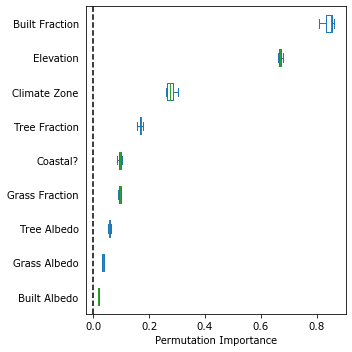

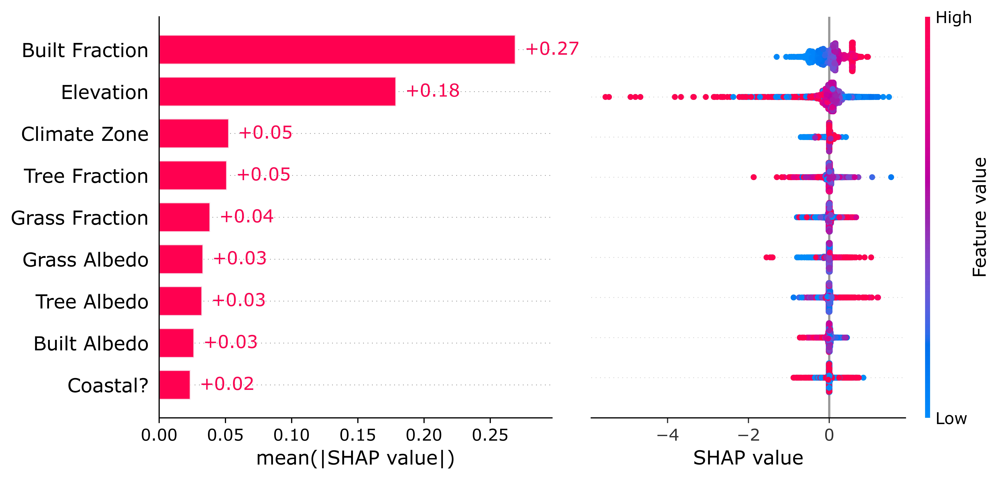

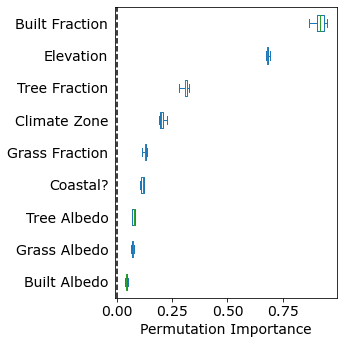

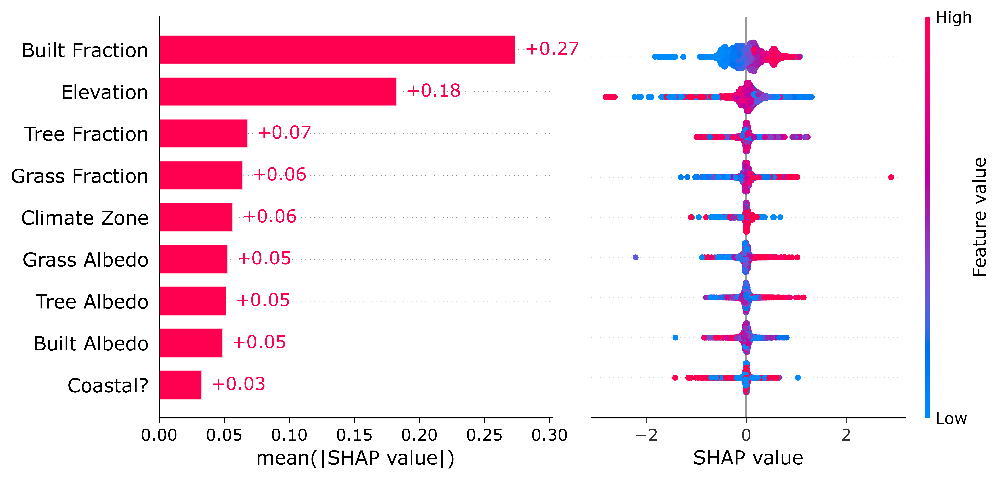

In [14]:
run_all('CUHI Day', 'cuhi_day')